# Image Classification Using Tensorflow

In [1]:
import os

In [2]:
import numpy as np

In [3]:
import matplotlib.pyplot as plt

In [4]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

In [5]:
from tensorflow.keras.models import Sequential

In [6]:
from tensorflow.keras.layers import Conv2D, Convolution2D

In [7]:
from tensorflow.keras.layers import MaxPool2D, MaxPooling2D

In [8]:
from tensorflow.keras.layers import Flatten

In [9]:
from tensorflow.keras.layers import Dense

In [10]:
import glob

In [11]:
from PIL import Image

In [12]:
import h5py

In [13]:
import warnings
warnings.filterwarnings('ignore')

In [14]:
dir_name_train_Mouse = 'Dataset/Train/Computer Mouse'
dir_name_train_Keyboard = 'Dataset/Train/Keyboard'
dir_name_train_Keys = 'Dataset/Train/Keys'
dir_name_train_Laptop = 'Dataset/Train/Laptop'
dir_name_train_Phone = 'Dataset/Train/Phone'
dir_name_train_Watch = 'Dataset/Train/Watch'

In [15]:
def plot_images(item_dir, n=6):
    all_item_dir = os.listdir(item_dir)
    item_files = [os.path.join(item_dir, file) for file in all_item_dir][:n]
    
    plt.figure(figsize=(80, 40))
    for idx, img_path in enumerate(item_files):
        plt.subplot(7, n, idx+1)
        img = plt.imread(img_path)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
    
    plt.tight_layout()

In [16]:
def Images_details_Print_data(data, path):
    print(" ====== Images in: ", path)    
    for k, v in data.items():
        print("%s:\t%s" % (k, v))

def Images_details(path):
    files = [f for f in glob.glob(path + "**/*.*", recursive=True)]
    data = {}
    data['images_count'] = len(files)
    data['min_width'] = 10**100  # No image will be bigger than that
    data['max_width'] = 0
    data['min_height'] = 10**100  # No image will be bigger than that
    data['max_height'] = 0


    for f in files:
        im = Image.open(f)
        width, height = im.size
        data['min_width'] = min(width, data['min_width'])
        data['max_width'] = max(width, data['max_height'])
        data['min_height'] = min(height, data['min_height'])
        data['max_height'] = max(height, data['max_height'])

    Images_details_Print_data(data, path)


Trainned data for Computer Mouse:

 ====== Images in:  Dataset/Train/Computer Mouse
images_count:	500
min_width:	224
max_width:	224
min_height:	224
max_height:	224



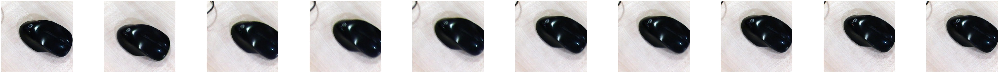

In [17]:
print("")
print("Trainned data for Computer Mouse:")
print("")
Images_details(dir_name_train_Mouse)
print("")
plot_images(dir_name_train_Mouse, 10)


Trainned data for Keyboard:

 ====== Images in:  Dataset/Train/Keyboard
images_count:	800
min_width:	224
max_width:	3060
min_height:	224
max_height:	3060



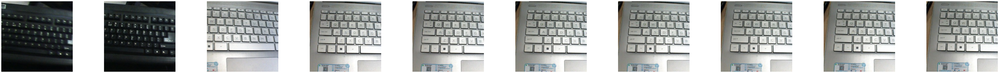

In [18]:
print("")
print("Trainned data for Keyboard:")
print("")
Images_details(dir_name_train_Keyboard)
print("")
plot_images(dir_name_train_Keyboard, 10)


Trainned data for Keys:

 ====== Images in:  Dataset/Train/Keys
images_count:	800
min_width:	224
max_width:	224
min_height:	224
max_height:	224



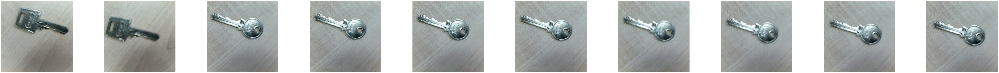

In [19]:
print("")
print("Trainned data for Keys:")
print("")
Images_details(dir_name_train_Keys)
print("")
plot_images(dir_name_train_Keys, 10)


Trainned data for Laptop:

 ====== Images in:  Dataset/Train/Laptop
images_count:	800
min_width:	224
max_width:	224
min_height:	224
max_height:	224



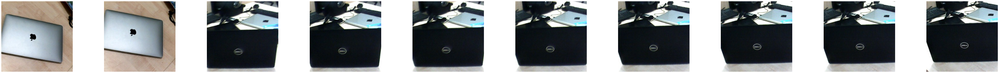

In [20]:
print("")
print("Trainned data for Laptop:")
print("")
Images_details(dir_name_train_Laptop)
print("")
plot_images(dir_name_train_Laptop, 10)


Trainned data for Phone:

 ====== Images in:  Dataset/Train/Phone
images_count:	800
min_width:	224
max_width:	3060
min_height:	224
max_height:	3060



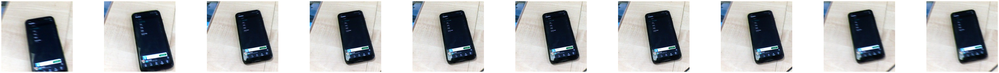

In [21]:
print("")
print("Trainned data for Phone:")
print("")
Images_details(dir_name_train_Phone)
print("")
plot_images(dir_name_train_Phone, 10)


Trainned data for Watch:

 ====== Images in:  Dataset/Train/Watch
images_count:	800
min_width:	160
max_width:	592
min_height:	154
max_height:	592



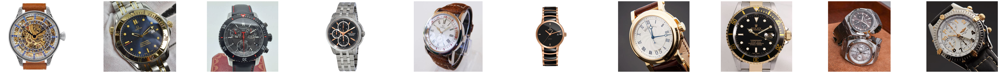

In [22]:
print("")
print("Trainned data for Watch:")
print("")
Images_details(dir_name_train_Watch)
print("")
plot_images(dir_name_train_Watch, 10)

In [23]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [24]:
train_datagen=ImageDataGenerator(rescale=1./255,shear_range=0.2,zoom_range=0.2,horizontal_flip=True)

In [25]:
test_datagen=ImageDataGenerator(rescale=1./255)

In [26]:
training_set=train_datagen.flow_from_directory('Dataset/Train',target_size=(224,224),batch_size=32,class_mode='categorical')
test_set=test_datagen.flow_from_directory('Dataset/Test',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 4500 images belonging to 6 classes.
Found 1187 images belonging to 6 classes.


# 

AlexNet Architecture

In [27]:
model = Sequential()
# 1st Convolutional Layer
model.add(Conv2D(input_shape=(224,224,3),filters=64,kernel_size=(3,3),padding="same", activation="relu"))
# 2nd Convolutional Layer
model.add(Conv2D(filters=64,kernel_size=(3,3),padding="same", activation="relu"))
model.add(MaxPool2D(pool_size=(2,2),strides=(2,2)))
# 3rd Convolutional Layer
model.add(Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
# 4th Convolutional Layer
model.add(Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
model.add(MaxPool2D(pool_size=(2,2),strides=(2,2)))
# 5th Convolutional Layer
model.add(Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
# 6th Convolutional Layer
model.add(Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
# 7th Convolutional Layer
model.add(Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
model.add(MaxPool2D(pool_size=(2,2),strides=(2,2)))
# 8th Convolutional Layer
model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
# 9th Convolutional Layer
model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
# 10th Convolutional Layer
model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(MaxPool2D(pool_size=(2,2),strides=(2,2)))
# 11th Convolutional Layer
model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
# 12th Convolutional Layer
model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
# 13th Convolutional Layer
model.add(Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(MaxPool2D(pool_size=(2,2),strides=(2,2),name='vgg16'))
model.add(Flatten(name='flatten'))
# 1st Fully Connected Layer
model.add(Dense(256, activation='relu', name='fc1'))
# 2nd Fully Connected Layer
model.add(Dense(128, activation='relu', name='fc2'))
# Output Layer
model.add(Dense(6, activation='sigmoid', name='output'))
model.summary()

# Compile the model
model.compile(loss = 'categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2  (None, 112, 112, 64)      0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 128)     73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 56, 56, 128)       0         
 g2D)                                                   

In [28]:
epochs = 5
batch_size = 512

In [29]:
model_path = "AlexNet.h5"

callbacks = [
    ModelCheckpoint(model_path, monitor='val_loss', verbose=1, save_best_only=True)
]

In [30]:
#### Fitting the model
AN = model.fit(training_set, steps_per_epoch=training_set.samples // batch_size, 
           epochs=epochs, 
           validation_data=test_set,validation_steps=test_set.samples // batch_size,
           callbacks = callbacks)

Epoch 1/5
8/8 [==============================] - ETA: 0s - loss: 1.8558 - accuracy: 0.2266 
Epoch 1: val_loss improved from inf to 1.82827, saving model to AlexNet.h5
8/8 [==============================] - 245s 30s/step - loss: 1.8558 - accuracy: 0.2266 - val_loss: 1.8283 - val_accuracy: 0.1250
Epoch 2/5
8/8 [==============================] - ETA: 0s - loss: 1.7928 - accuracy: 0.1797 
Epoch 2: val_loss improved from 1.82827 to 1.79454, saving model to AlexNet.h5
8/8 [==============================] - 233s 29s/step - loss: 1.7928 - accuracy: 0.1797 - val_loss: 1.7945 - val_accuracy: 0.1250
Epoch 3/5
8/8 [==============================] - ETA: 0s - loss: 1.7865 - accuracy: 0.1680 
Epoch 3: val_loss did not improve from 1.79454
8/8 [==============================] - 233s 29s/step - loss: 1.7865 - accuracy: 0.1680 - val_loss: 1.7999 - val_accuracy: 0.2188
Epoch 4/5
8/8 [==============================] - ETA: 0s - loss: 1.7883 - accuracy: 0.1758 
Epoch 4: val_loss did not improve from 1.794

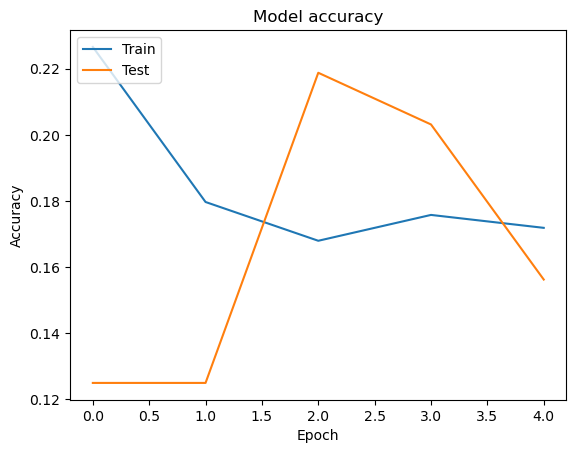

In [31]:
def acc():
    #Plot training & validation accuracy values
    plt.plot(AN.history['accuracy'])
    plt.plot(AN.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
acc()

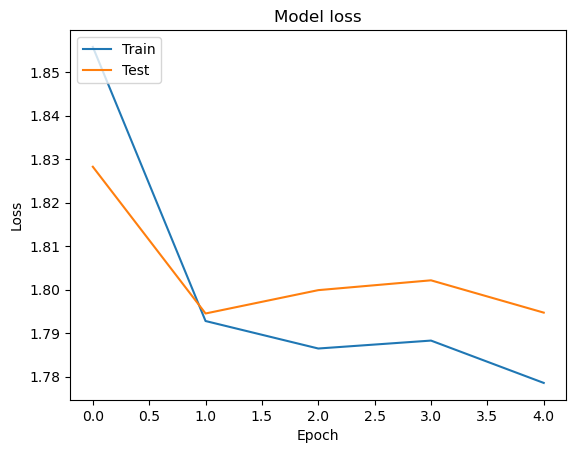

In [32]:
def loss():
    # Plot training & validation loss values
    plt.plot(AN.history['loss'])
    plt.plot(AN.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
loss()

# 

LeNet Architecture

In [33]:
Classifier=Sequential()
Classifier.add(Convolution2D(filters=32, kernel_size=(3,3), strides=(3,3), input_shape=(224,224,3), padding=('valid'), activation='relu'))
Classifier.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), padding='valid'))
Classifier.add(Convolution2D(filters=128, kernel_size=(3,3), strides=(3,3), padding=('valid'), activation='relu'))
Classifier.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), padding='valid'))
Classifier.add(Flatten())
Classifier.add(Dense(120, activation='relu'))
Classifier.add(Dense(84, activation='relu'))
Classifier.add(Dense(6, activation='softmax'))

Classifier.compile(optimizer='rmsprop',loss='categorical_crossentropy',metrics=['accuracy'])
Classifier.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_19 (Conv2D)          (None, 74, 74, 32)        896       
                                                                 
 max_pooling2d_10 (MaxPooli  (None, 37, 37, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_20 (Conv2D)          (None, 12, 12, 128)       36992     
                                                                 
 max_pooling2d_11 (MaxPooli  (None, 6, 6, 128)         0         
 ng2D)                                                           
                                                                 
 flatten_3 (Flatten)         (None, 4608)              0         
                                                                 
 dense_9 (Dense)             (None, 120)              

In [34]:
epochs = 5
batch_size = 32

In [35]:
model_path = "LeNet.h5"

callbacks = [
    ModelCheckpoint(model_path, monitor='val_loss', verbose=1, save_best_only=True)
]

In [36]:
LN = Classifier.fit(training_set, steps_per_epoch=training_set.samples // batch_size, 
           epochs=epochs, 
           validation_data=test_set,validation_steps=test_set.samples // batch_size,
           callbacks = callbacks)

Epoch 1/5
140/140 [==============================] - ETA: 0s - loss: 0.8727 - accuracy: 0.6871
Epoch 1: val_loss improved from inf to 0.20404, saving model to LeNet.h5
140/140 [==============================] - 192s 1s/step - loss: 0.8727 - accuracy: 0.6871 - val_loss: 0.2040 - val_accuracy: 0.9451
Epoch 2/5
140/140 [==============================] - ETA: 0s - loss: 0.3048 - accuracy: 0.9085
Epoch 2: val_loss improved from 0.20404 to 0.10103, saving model to LeNet.h5
140/140 [==============================] - 188s 1s/step - loss: 0.3048 - accuracy: 0.9085 - val_loss: 0.1010 - val_accuracy: 0.9840
Epoch 3/5
140/140 [==============================] - ETA: 0s - loss: 0.1600 - accuracy: 0.9499
Epoch 3: val_loss improved from 0.10103 to 0.09486, saving model to LeNet.h5
140/140 [==============================] - 189s 1s/step - loss: 0.1600 - accuracy: 0.9499 - val_loss: 0.0949 - val_accuracy: 0.9780
Epoch 4/5
140/140 [==============================] - ETA: 0s - loss: 0.1462 - accuracy: 0.95

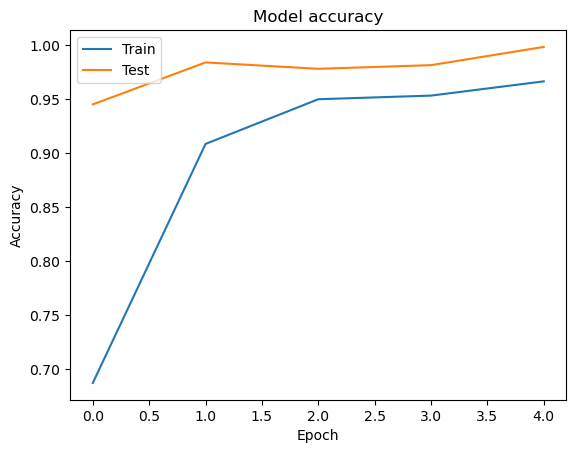

In [37]:
def acc():
    #Plot training & validation accuracy values
    plt.plot(LN.history['accuracy'])
    plt.plot(LN.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
acc()

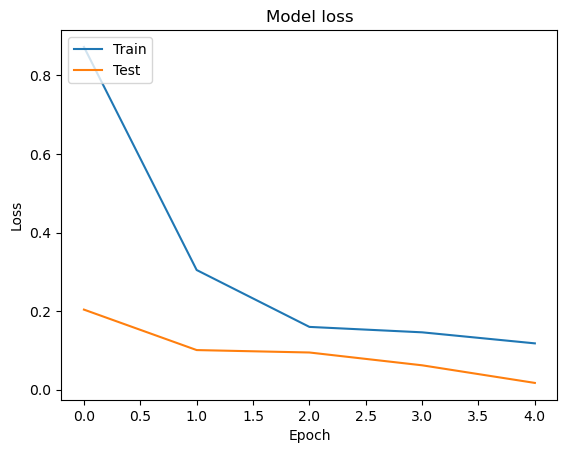

In [38]:
def loss():
    # Plot training & validation loss values
    plt.plot(LN.history['loss'])
    plt.plot(LN.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
loss()